# Import Libraries

In [1]:
import pandas as pd
import numpy as np
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx
import geoplot as gplt

import plotly.express as px

In [2]:
from shapely import wkt

## Import Data
---
### Grab Shape File for CA

In [4]:
# Read in the shape file of counties for CA
shape = gpd.read_file('./CA_Counties_TIGER2016.shp')

# Assign the crs code for this image (3857 (pseudo mercater))
shape.crs = "epsg:3857"

### Grabbing COVID-19 cases in CA

In [21]:
place_url = 'https://raw.githubusercontent.com/datadesk/california-coronavirus-data/master/latimes-place-totals.csv'
totals = pd.read_csv(place_url)
totals.head()

,date,county,fips,place,confirmed_cases,note,x,y
0,2020-03-16,Los Angeles,37,Alhambra,2,NaN,-118.135504,34.083961
1,2020-03-16,Los Angeles,37,Arcadia,1,NaN,-118.037297,34.134186
2,2020-03-16,Los Angeles,37,Beverly Hills,1,NaN,-118.402109,34.078543
3,2020-03-16,Los Angeles,37,Boyle Heights,5,NaN,-118.205330,34.038150
4,2020-03-16,Los Angeles,37,Carson,1,NaN,-118.255878,33.837391


In [3]:
totals.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28996 entries, 0 to 28995
Data columns (total 8 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   date             28996 non-null  object 
 1   county           28996 non-null  object 
 2   fips             28996 non-null  int64  
 3   place            28996 non-null  object 
 4   confirmed_cases  28996 non-null  int64  
 5   note             2281 non-null   object 
 6   x                28337 non-null  float64
 7   y                28337 non-null  float64
dtypes: float64(2), int64(2), object(4)
memory usage: 1.8+ MB


#### Clean data

In [30]:
# Grab the index for values that need fixing
san_mateo_fixes = totals[totals.x > 120].index

# Fix the lat value
totals.loc[san_mateo_fixes, 'x'] = -totals.loc[san_mateo_fixes, 'x']

In [31]:
totals.loc[san_mateo_fixes, 'x']

26662   -122.480689
28896   -122.480689
Name: x, dtype: float64

In [8]:
# Cleaning one row of data for latitude
totals.loc[21434,'x'] = -122.48068899999998

In [35]:
totals['x'].describe()

count    27560.000000
mean      -118.651874
std          2.163587
min       -124.142778
25%       -118.636070
50%       -118.292604
75%       -117.865044
max        122.480689
Name: x, dtype: float64

### Converting coronavirus places to geopandas coordinates


In [36]:
# Insert Geometry and set the crs to 4326 (degree data)
gdf = gpd.GeoDataFrame(crs = 4326, geometry = gpd.points_from_xy(totals['x'],totals['y']))
gdf['confirmed_cases'] = totals['confirmed_cases']
gdf['date'] = totals['date']

# Convert CRS to mercater
#gdf.to_crs(epsg = 4326, inplace = True)
gdf.to_crs(epsg = 3857, inplace = True)

### Plotting CA

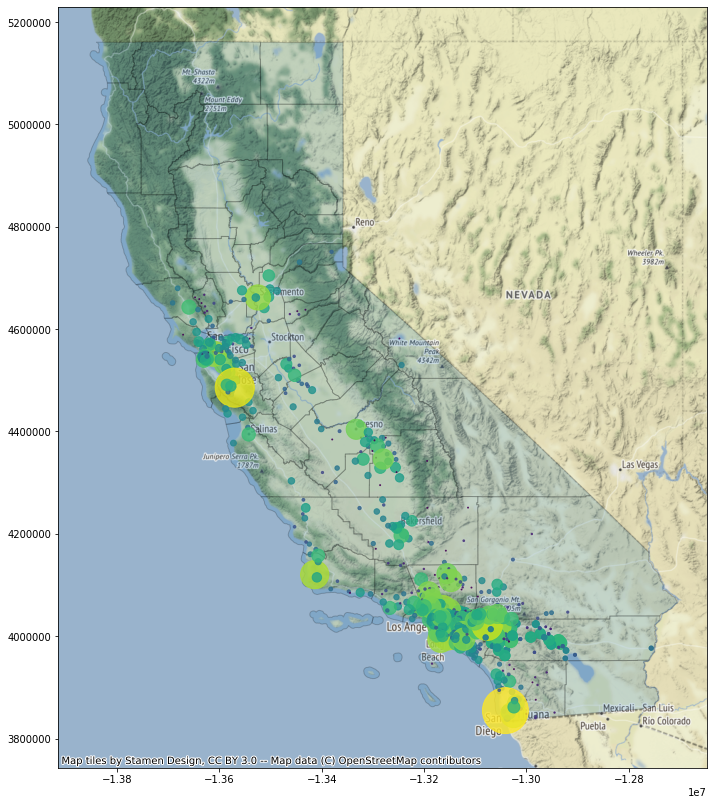

In [67]:
date = '2020-05-0'

# plotting the shapefile
ax = shape.plot(figsize = (14,14),alpha=0.2, edgecolor='k')

# plotting the cases
plt.scatter(x = gdf[gdf['date'] == date]['geometry'].x, 
            y = gdf[gdf['date'] == date]['geometry'].y, 
            s = gdf[gdf['date'] == date]['confirmed_cases'], 
            c = np.log(gdf[gdf['date'] == date]['confirmed_cases']), 
            alpha = 0.8)

# adding contextily background
ctx.add_basemap(ax, attribution_size = 10)

In [6]:
shape.head()

,geometry
0,"POLYGON ((-13431319.751 4821511.426, -13431312..."
1,"POLYGON ((-13490651.476 4680831.603, -13490511..."
2,"MULTIPOLYGON (((-13423116.772 4042044.149, -13..."
3,"POLYGON ((-13428575.483 4627725.228, -13428534..."
4,"MULTIPOLYGON (((-13317853.594 3931602.414, -13..."


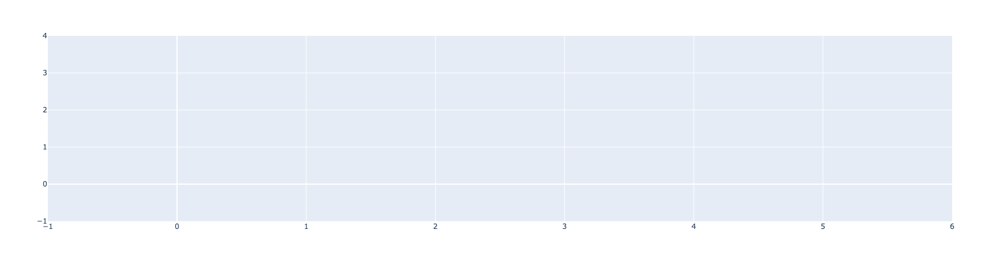

In [9]:
fig = px.choropleth_mapbox(shape)
fig.show()

px.scatter_geo

# Antiquated 
---

In [8]:
from urllib.request import urlopen

import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv",
                   dtype={"fips": str})

In [70]:
df

,fips,unemp
0,01001,5.3
1,01003,5.4
2,01005,8.6
3,01007,6.6
4,01009,5.5
...,...,...
3214,72145,13.9
3215,72147,10.6
3216,72149,20.2
3217,72151,16.9


In [89]:
totals.set_index(keys = 'date', inplace = True)

In [93]:
date = '2020-05-09'
df2 = totals.loc[date].groupby(by='fips').sum()
df2['fips'] = df2.index
df2.drop(columns = ['x','y'], inplace = True)

In [95]:
df2['fips'] = ['0600' + str(fip) if len(fip) == 1 else '060' + str(fip) if len(fip) == 2 else '06'+str(fip) for fip in df2['fips'].astype(str)]
#county = gpd.GeoDataFrame(counties['features'])

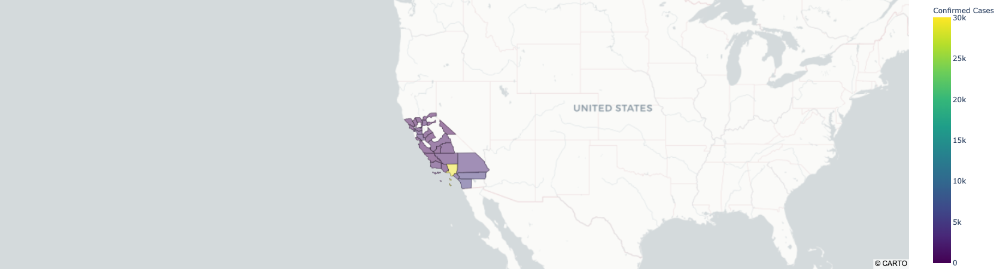

In [96]:
fig = px.choropleth_mapbox(df2, geojson=counties, locations='fips', color='confirmed_cases',
                           color_continuous_scale="Viridis",
                           range_color=(0, 30000),
                           mapbox_style="carto-positron",
                           zoom=3, center = {"lat": 37.0902, "lon": -95.7129},
                           opacity=0.5,
                           labels={'confirmed_cases':'Confirmed Cases'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [45]:
nyt_counties_url = 'https://raw.githubusercontent.com/nytimes/covid-19-data/master/us-counties.csv'

counties = pd.read_csv(nyt_counties_url)

In [64]:
window = (counties['state'] == 'New York') & (counties['county'] == 'New York City')
counties[window].sort_values(by = 'date', ascending = False)

,date,county,state,fips,cases,deaths
131464,2020-05-10,New York City,New York,NaN,189656,19436
128553,2020-05-09,New York City,New York,NaN,188663,19324
125642,2020-05-08,New York City,New York,NaN,187157,19210
122736,2020-05-07,New York City,New York,NaN,185653,19141
119837,2020-05-06,New York City,New York,NaN,183770,18993
...,...,...,...,...,...,...
565,2020-03-05,New York City,New York,NaN,4,0
518,2020-03-04,New York City,New York,NaN,2,0
482,2020-03-03,New York City,New York,NaN,2,0
448,2020-03-02,New York City,New York,NaN,1,0


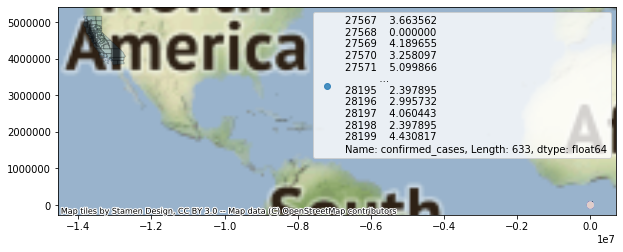

In [65]:
ax = shape.plot(figsize=(10, 10), alpha=0.2, edgecolor='k')
#plt.ylim((3800000,5200000))
#plt.xlim((-1.4, -1.2))

date = '2020-05-10'

scatter = plt.scatter(totals[totals['date'] == date]['x'], 
              totals[totals['date'] == date]['y'], 
              c = np.log(totals[totals['date'] == date]['confirmed_cases']), 
              cmap = 'coolwarm', 
              label = np.log(totals[totals['date'] == date]['confirmed_cases']), 
              alpha = 0.8)

plt.legend()
ctx.add_basemap(ax, zoom = 1)
#legend = ax2.legend(scatter.legend_elements(num=5))

{'whiskers': [<matplotlib.lines.Line2D at 0x12f9ad4d0>,
 'caps': [<matplotlib.lines.Line2D at 0x12f9adf10>,
 'boxes': [<matplotlib.lines.Line2D at 0x12fa5ab90>],
 'medians': [<matplotlib.lines.Line2D at 0x12f9b1950>],
 'fliers': [<matplotlib.lines.Line2D at 0x12f9b1e90>],
 'means': []}

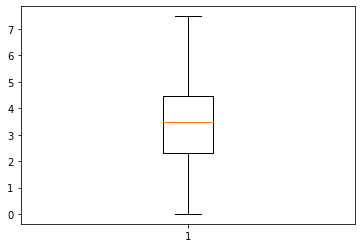

In [45]:
plt.boxplot(np.log(totals[totals['date'] == date]['confirmed_cases']))

In [78]:
df = gpd.read_file(filename = './29cf4af7-592a-4db9-989f-da45bbbc11ba2020412-1-12wq9tx.ten9.shp')
#df = df.to_crs(epsg=3857, inplace = True)

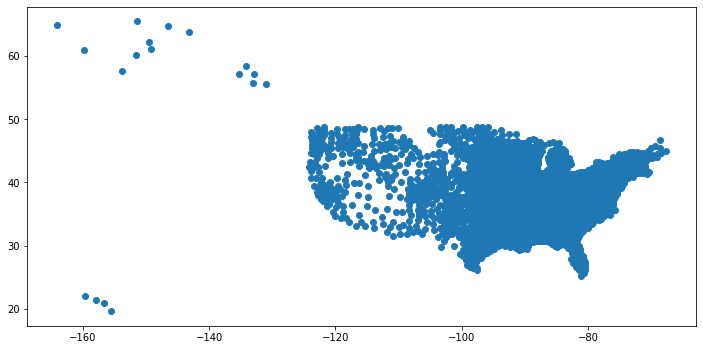

In [81]:
df.plot(figsize = (12,12))


,geometry
0,POINT (-82.46171 34.22333)
1,POINT (-92.41420 30.29506)
2,POINT (-75.63235 37.76707)
3,POINT (-116.24155 43.45266)
4,POINT (-94.47106 41.33076)
...,...
2957,POINT (-113.90667 32.76896)
2958,POINT (-102.42587 40.00347)
2959,POINT (-99.16987 27.00156)
2960,POINT (-99.76051 28.86617)


In [13]:
url = 'https://raw.githubusercontent.com/nytimes/covid-19-data/master/us-counties.csv'
test = pd.read_csv(url)

In [14]:
test.head()

,date,county,state,fips,cases,deaths
0,2020-01-21,Snohomish,Washington,53061.0,1,0
1,2020-01-22,Snohomish,Washington,53061.0,1,0
2,2020-01-23,Snohomish,Washington,53061.0,1,0
3,2020-01-24,Cook,Illinois,17031.0,1,0
4,2020-01-24,Snohomish,Washington,53061.0,1,0


In [15]:
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 135570 entries, 0 to 135569
Data columns (total 6 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   date    135570 non-null  object 
 1   county  135570 non-null  object 
 2   state   135570 non-null  object 
 3   fips    134025 non-null  float64
 4   cases   135570 non-null  int64  
 5   deaths  135570 non-null  int64  
dtypes: float64(1), int64(2), object(3)
memory usage: 6.2+ MB


In [26]:
# Reassign our fips to be a string of length 5
test['fips'] = test['fips'].astype(str).apply(lambda x : x[:5])

In [6]:
test['fips'] = test['fips']

In [12]:
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 135570 entries, 0 to 135569
Data columns (total 6 columns):
 #   Column  Non-Null Count   Dtype 
---  ------  --------------   ----- 
 0   date    135570 non-null  object
 1   county  135570 non-null  object
 2   state   135570 non-null  object
 3   fips    135570 non-null  object
 4   cases   135570 non-null  int64 
 5   deaths  135570 non-null  int64 
dtypes: int64(2), object(4)
memory usage: 6.2+ MB


In [30]:
test[test['state'] == 'California']

,date,county,state,fips,cases,deaths
5,2020-01-25,Orange,California,6059.,1,0
9,2020-01-26,Los Angeles,California,6037.,1,0
10,2020-01-26,Orange,California,6059.,1,0
14,2020-01-27,Los Angeles,California,6037.,1,0
15,2020-01-27,Orange,California,6059.,1,0
...,...,...,...,...,...,...
132879,2020-05-11,Tulare,California,6107.,1159,50
132880,2020-05-11,Tuolumne,California,6109.,2,0
132881,2020-05-11,Ventura,California,6111.,690,19
132882,2020-05-11,Yolo,California,6113.,174,20


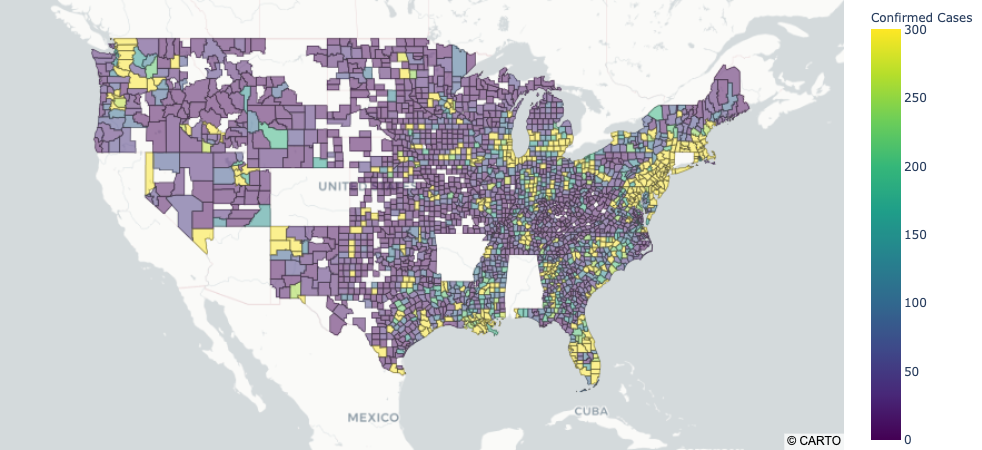

In [28]:
fig = px.choropleth_mapbox(test, geojson=counties, locations='fips', color='cases',
                           color_continuous_scale="Viridis",
                           range_color=(0, 300),
                           mapbox_style="carto-positron",
                           zoom=3, center = {"lat": 37.0902, "lon": -95.7129},
                           opacity=0.5,
                           labels={'cases':'Confirmed Cases'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()